As a consultant for Olist (online solution for marketplaces),
we are commissioned to segment their client database. <br>
The goal is to establish a base for their communication campaigns. <br> 
They also require a maintenance contract based on a stability analysis of the different segments over time.

pd.show_versions() <br>
pandas version : 1.0.5 <br>
numpy version : 1.18.5 <br>
seaborn version : 0.11.2 <br>
matplotlib version : 3.2.2 <br>

This is the tryout notebook where I put to the test different clustering algorithms <br>
- : Usual loadings <br>
Part - 1 <a href='#simple'> Simple models <br>
$\;\;\;\;\;\;$ <a href='#pareto'> Pareto law <br>
$\;\;\;\;\;\;$ <a href='#abc'> ABC method <br>
$\;\;\;\;\;\;$ <a href='#hand'> RFM method <br>
$\;\;\;\;\;\;$ <a href='#Krfm'> Kmeans RFM <br>
    
Part 2 - KMeans with more parameters <br>
$\;\;\;\;\;\;$ <a href='#5means'> KMeans with 5 <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#elbo'> Elbow method </a> <br> 
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#davi'> David Bouldin method </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#silho'> Silhouette method </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#inter'> Intercluster Distance Maps </a> <br>
$\;\;\;\;\;\;$ <a href='#catmeans'> KMeans 5 with categories <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#nclus'> Best number of clusters </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pcav'> PCA vizualisation </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#cread'> Reading the cluster </a> <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#extra'> Extra readings </a> <br>
$\;\;\;\;\;\;$ <a href='#full'> Full feature engineering with PCA <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pcafull'> Full features PCA <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pcafullnumb'> Best number of clusters <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pca15'> Kmeans_PCA 15 <br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ <a href='#pca5'> Kmeans_PCA 7 <br>
    
Part - 3 Other Algorithmes <br>
$\;\;\;\;\;\;$ <a href='#agglo'> Agglomerative Hierarchical Clustering <br>
$\;\;\;\;\;\;$ <a href='#dbsc'> DBSCAN <br>

#### Usual imports and options

In [1]:
#pip install plotly==5.4.0 # for plotly.express

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from math import * #for ceil()

In [39]:
import plotly.graph_objects as go

In [3]:
# col width
pd.set_option('max_colwidth', 120)
# option to be able see all columns
pd.set_option('max_columns', None)
# max lanes display
pd.options.display.max_rows = 5000

In [4]:
import time

In [5]:
start = time.time()
dorder = pd.read_csv('dorder_clean10.csv')
dorder.drop(['Unnamed: 0'], axis = 1, inplace=True)
dorder.drop(['Unnamed: 69'], axis = 1, inplace=True)
end = time.time()
print("total time: ",(end - start),"sec")

total time:  1.5407724380493164 sec


In [6]:
# Transformers
from sklearn import preprocessing
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler

In [7]:
from sklearn import decomposition
from sklearn.decomposition import PCA
from functions import *

In [8]:
from sklearn.cluster import KMeans
from sklearn import cluster, metrics
import scipy.cluster.hierarchy as shc
from scipy.cluster.hierarchy import fcluster
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster.hierarchy import cophenet
from scipy.spatial.distance import pdist
from sklearn.cluster import DBSCAN

In [9]:
#pip install yellowbrick # for Yellobrick visualisations

In [10]:
# Visualisation

from sklearn.cluster import MiniBatchKMeans
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance, intercluster_distance

In [11]:
#preprocessing
std_scale = preprocessing.StandardScaler()

In [12]:
# tnse
from matplotlib.ticker import NullFormatter
from sklearn import manifold, datasets

#### fonctions

In [14]:
#pip install bioinfokit

In [15]:
# get ANOVA table as R like output
import statsmodels.api as sm
from statsmodels.formula.api import ols
from bioinfokit.analys import stat

In [16]:
# Boxplot function + ANNOVA + STATS (p value for the whole and 2 by 2)
# df : name of the dataframe
# x is the name of the qualitative column (example : 'category')
# y is the name of the quantitative column (example : 'value')
# Tukey = 1 (stats 2 by 2)
# showfliers on/off ; sort = 1 : sort the resulting boxplot

def boxplots(df, x, y, tukey=1, size=(8,6), showfliers=False, sort = 0, font=50) :

    dfnona = df[df[y].notna()]
    X = x # qualitative
    Y = y # quantitative

    if sort == 1 :
        modalites = sorted(dfnona[X].unique(), reverse=False)
    elif sort == 2 :
        modalites = sorted(dfnona[X].unique(), reverse=True)
    else :
        modalites = dfnona[X].unique()
        
    groupes = []
    for m in modalites:
        groupes.append(dfnona[dfnona[X]==m][Y])

    # Propriétés graphiques (pas très importantes)    
    medianprops = {'color':"black"}
    meanprops = {'marker':'o', 'markeredgecolor':'black',
                'markerfacecolor':'firebrick'}

    fig, ax = plt.subplots(figsize=size)
    ax.set_title(str(x)+' / '+str(y), fontsize=16)
    ax.set_xlabel(y, fontsize=14)
    ax.set_ylabel(x, fontsize=14) 
    # medianpropsdict, default: None / The style of the median
    # meanpropsdict, default: None / The style of the mean
    # vertbool, default: True / If True, draws vertical boxes. If False, draw horizontal boxes.
    # patch_artistbool, default: False / If False produces boxes with the Line2D artist. Otherwise, with Patch artists.
    plt.boxplot(
        groupes,
        labels=modalites,
        showfliers=showfliers,
        medianprops=medianprops,
        vert=False,
        patch_artist=True,
        showmeans=True,
        meanprops=meanprops
    )
    plt.show()
    plt.rcParams.update({"font.size" : font})   
    
    df2 = df.melt(id_vars=[X], value_vars=[Y])
    df2.columns = ['catquali', 'attribut', 'value']
    
    # Ordinary Least Squares (OLS) model
    modelanova = ols('value ~ C(catquali)', data=df2).fit()
    anova_table = sm.stats.anova_lm(modelanova, typ=2)
    print(anova_table)
    
    # we will use bioinfokit (v1.0.3 or later) for performing tukey HSD test
    # #pip install bioinfokit
    # check documentation here https://github.com/reneshbedre/bioinfokit
    # perform multiple pairwise comparison (Tukey's HSD)
    # unequal sample size data, tukey_hsd uses Tukey-Kramer test
    if tukey == 1 :
        res = stat()
        res.tukey_hsd(df=df2, res_var='value', xfac_var='catquali', anova_model='value ~ C(catquali)')
        print(res.tukey_summary)

In [17]:
#Pivot table for two qualitative categories + fig
# df : name of the dataframe
# x is the name of the first qualitative column (example : 'category')
# y is the name of the second qualitative column (example : 'day')
# heat = 1 give the total count ; size of the figure

def qualiquali(df, x, y, piv=1, fig = 1, size = (15, 10), fig_norm = 1, poli = 2, heat = 1, size2 = (8, 6)) :
    
    X = x
    Y = y

    cont = df[[X,Y]].pivot_table(index=X,columns=Y,aggfunc=len,margins=True,margins_name="Total")
    if piv == 1 :
        print(cont)
        
    if fig == 1 :
        plt.figure(figsize = size)
        sns.countplot(y= Y, hue= X, data=df);
        
    if fig_norm == 1 :
        u = df[Y].unique()

        cola = []
        colb = []
        colc = []
 
        for i in range(len(u)) :
            guecko = df[df[Y].isin([u[i]])][X].value_counts()
            norma = lambda x: (x - min(x)) / (max(x) - min(x))
            gogo = guecko.transform(norma)    # apply the normalisation
    
            for y in range(len(gogo)) :
                a = u[i] # the unique category of Y selected
                b = gogo.index.tolist()[y]    # the unique category of X associated
                c = gogo.tolist()[y]    # value_counts
        
                cola.append(a)
                colb.append(b)
                colc.append(c)
    
        zipped = list(zip(cola, colb, colc))
        vcount = 'value_counts'
        dfs = pd.DataFrame(zipped, columns=[Y, X, vcount])
        #print(dfs)

        bsize = (len(u) * len(df[X].unique()))/4
        size = (20, bsize)
        plt.figure(figsize = size)
        sns.barplot(x=vcount, y=Y, hue=X, data=dfs)
        sns.set(font_scale = poli)
        plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        
    if heat == 1 :
        tx = cont.loc[:,["Total"]]
        ty = cont.loc[["Total"],:]
        n = len(df)
        indep = tx.dot(ty) / n

        plt.figure(figsize = size2)
        c = cont.fillna(0) # On remplace les valeurs nulles par 0
        measure = (c-indep)**2/indep
        xi = measure.sum().sum()
        table = measure/xi
        #sns.heatmap(table.iloc[:-1,:-1],annot=c.iloc[:-1,:-1]) # add the numbers on the heatmap
        sns.heatmap(table.iloc[:-1,:-1])
        plt.show()

In [18]:
# fig  + linear regression
from sklearn import linear_model

def quantiquanti(df, cat1, cat2, regl = 0, co = 0) :
    
    X = cat1
    Y = cat2
    Z = df[[X, Y]].copy().dropna()

    reg = linear_model.LinearRegression()
    reg.fit(Z[[X]], Z[Y])
    rez = reg.predict(Z[[X]])
    
    if co == 1 :
        # Coefficient
        print('Coefficients: \n', reg.coef_)
        # The mean squared error
        print('Mean squared error: %.2f'
          % mean_squared_error(Z[X], Z[Y]))
        # Coefficient de détermination: 1 est la prédiction parfaite
        print('Coefficient of determination: %.2f'
          % r2_score(Z[X], Z[Y]))
    
    plt.scatter(Z[X], Z[Y],  color='blue')
    
    if regl == 1 :
        plt.plot(Z[X], rez, color='red', linewidth=1)
    
    plt.xlabel(X)
    plt.ylabel(Y)

    plt.show()

In [41]:
def polarplt(df, cluster_column, selection) :
    # selection are the criteria represented in the polar plot

    fig = go.Figure()
    
    names = []    
    mean_Number_of_orders = []
    selected = list(df)
    clusters_uniq = df[cluster_column].unique()

    for i in range(len(clusters_uniq)) :
        names.append('cluster' + ' ' + str(clusters_uniq[i]))
        means_c = []
        Mean_cluster = df[df[cluster_column].isin([clusters_uniq[i]])]
        for y in range(len(selection)) :
            a = Mean_cluster[selection[y]]
            norma = ((a - min(a)) / (max(a) - min(a)))
            norma = a / max(a)
            meana = norma.mean()
            means_c.append(norma.mean())
    
        fig.add_trace(go.Scatterpolar(r=means_c, theta=selected, name=names[i]))
    
    fig.update_layout(
      polar=dict(
        radialaxis=dict(
          visible=True,
          range=[0, 1]
        )),
      showlegend=True
    )
    fig.show()

## Selecting one lane for each customer

In [19]:
#Keeping only one lane per unique customer
dat = dorder.copy()

print(dat.shape)
print('--'*5)

dat.drop_duplicates(subset ="customer_unique_id", inplace = True)

print(dat.shape)
# Reloading after restart

(116975, 77)
----------
(94397, 77)


In [18]:
# dat = one lane for one customer
len(dat[dat['Number_of_orders'] > 1])

2861

<a id='simple' />

# Part 1 - Simple models

<a id='pareto' />

# I - Pareto law

In [19]:
dorder.head(1)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,distance,geo_mlat_customer,geo_mlng_customer,seller_zip_code_prefix,seller_city,seller_state,geo_mlat_seller,geo_mlng_seller,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,Time_of_purchase,Time_of_purchase_sec,Number_of_orders,First_order_time,Last_order_time,Recency,Frequency,total_payment_value,tot_customer_spending,mean_review_score,order_delivered_time,order_estimated_delivery,delay_delivery,categories,Number_of_articles,mean_spending,Most_used_method_of_payment,Method_used_to_spend_the_most,MUM_of_payment_a,MU_to_spend_the_most_a,Preferred category,cool_stuff,pet_shop,home_confort,health_beauty,electronics,industry_commerce_construction,arts_video_audio,clothing_and_bags,auto,alpha_cats,Cus_mean_review_score
0,00010242fe8c5a6d1ba2dd792cb16214,1.0,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29,1.0,credit_card,2.0,72.19,97ca439bc427b48bc1cd7177abe71365,5.0,Unknown,"Perfeito, produto entregue antes do combinado.",2017-09-21 00:00:00,2017-09-22 10:57:03,3ce436f183e68e07877b285a838db11a,delivered,2017-09-13 08:59:02,2017-09-13 09:45:35,2017-09-19 18:34:16,2017-09-20 23:43:48,2017-09-29 00:00:00,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,2.945252,-21.762775,-41.309633,27277.0,volta redonda,SP,-22.496953,-44.127492,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,cool_stuff,621.290995,53679542.0,1,53679542,53679542,355.005498,1.0,72.19,72.19,5.0,628.905417,636.916667,8.01125,cool_stuff,1,72.19,credit_card,credit_card,1,1,cool_stuff,1,0,0,0,0,0,0,0,0,1,5.0


In [20]:
name_of_the_cat = []
over_total = []

total = dat['tot_customer_spending'].sum()
catego = dat['categories'].unique()

for i in range(len(catego)) :
    dfcat = dat[dat['categories'].isin([catego[i]])]
    over_total.append(dfcat['tot_customer_spending'].sum())
    name_of_the_cat.append(catego[i])
    
for i in range(len(name_of_the_cat)) :
    print('The category :', name_of_the_cat[i], ', represent ', (over_total[i]*100)/total, '% of the overal turnover')

The category : cool_stuff , represent  17.408221668079086 % of the overal turnover
The category : pet_shop , represent  1.6000942673653047 % of the overal turnover
The category : nan , represent  1.315088117900032 % of the overal turnover
The category : home_confort , represent  26.85621130742277 % of the overal turnover
The category : health_beauty , represent  19.799950022204193 % of the overal turnover
The category : electronics , represent  9.720650814854261 % of the overal turnover
The category : industry_commerce_construction , represent  7.878937687887677 % of the overal turnover
The category : arts_video_audio , represent  5.488454639350162 % of the overal turnover
The category : clothing_and_bags , represent  5.619862772702793 % of the overal turnover
The category : auto , represent  4.312528702233722 % of the overal turnover


In [21]:
#Does 80% of the total revenue is generated by 20% of the clients ?
Pareto = dat.sort_values(by=['tot_customer_spending'], ascending=False).reset_index()
Pareto.head(2)

,index,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,distance,geo_mlat_customer,geo_mlng_customer,seller_zip_code_prefix,seller_city,seller_state,geo_mlat_seller,geo_mlng_seller,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,Time_of_purchase,Time_of_purchase_sec,Number_of_orders,First_order_time,Last_order_time,Recency,Frequency,total_payment_value,tot_customer_spending,mean_review_score,order_delivered_time,order_estimated_delivery,delay_delivery,categories,Number_of_articles,mean_spending,Most_used_method_of_payment,Method_used_to_spend_the_most,MUM_of_payment_a,MU_to_spend_the_most_a,Preferred category,cool_stuff,pet_shop,home_confort,health_beauty,electronics,industry_commerce_construction,arts_video_audio,clothing_and_bags,auto,alpha_cats,Cus_mean_review_score
0,87939,03caa2c082116e1d31e67e9ae3700499,1.0,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06 15:28:20,1680.0,28.01,1.0,credit_card,1.0,13664.08,211fa81a22870cc634265ea85b751e40,1.0,Unknown,"Peço por favor verificar a entrega do pedido, pois não recebemos.",2017-10-18 00:00:00,2017-10-19 13:10:39,1617b1357756262bfa56ab541c47bc16,delivered,2017-09-29 15:24:52,2017-10-02 15:28:20,2017-10-10 15:43:17,2017-10-17 18:22:29,2017-10-23 00:00:00,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,3.403692,-22.901209,-43.184957,3667.0,sao paulo,SP,-23.531307,-46.494795,telefonia_fixa,39.0,2493.0,3.0,750.0,16.0,16.0,16.0,fixed_telephony,637.558935,55085092.0,1,55085092,55085092,338.737558,1.0,13664.08,13664.08,1.0,655.682280,660.916667,5.234387,arts_video_audio,8,1708.010,credit_card,credit_card,1,1,arts_video_audio,0,0,0,0,0,0,8,0,0,7,1.0
1,110836,8ea7aebc18842332aad5f41ca74b334c,1.0,3ecf69ee1fe21cfd40b30cbea549e563,59417c56835dd8e2e72f91f809cd4092,2017-04-19 13:25:19,2589.0,32.29,1.0,credit_card,10.0,2621.29,51d8c7fe1241e5d4cab50cedf8264985,5.0,Unknown,None,2017-04-18 00:00:00,2017-04-19 01:28:52,349509b216bd5ec11c5fae929fd13595,delivered,2017-04-01 15:58:41,2017-04-03 13:25:19,2017-04-11 14:42:25,2017-04-17 14:36:23,2017-05-09 00:00:00,da122df9eeddfedc1dc1f5349a1a690c,28970,araruama,RJ,5.052182,-22.869657,-42.321415,13480.0,limeira,SP,-22.570721,-47.403095,eletroportateis,41.0,3564.0,1.0,6300.0,35.0,35.0,30.0,small_appliances,456.582419,39448721.0,2,39448720,39448721,519.714074,2.0,2621.29,7571.63,5.0,472.525266,493.916667,21.391400,home_confort,2,3785.815,credit_card,credit_card,1,1,home_confort,0,0,2,0,0,0,0,0,0,3,5.0


In [22]:
heighty = Pareto['tot_customer_spending'].sum()*80/100
heighty

12523833.631999997

In [23]:
somme = 0
pareto_index = 0

for i in range(Pareto.shape[0]) :
    somme = somme + Pareto['tot_customer_spending'].values[i]
    if somme > heighty :
        pareto_index = i
        break
print(pareto_index)

45970


In [24]:
Pareto.shape[0]*20/100

18879.4

#### The Pareto law doesn't fit here !
Does it work withing categories ?

In [25]:
name_of_the_cat = []
pareto_index_c = []
pareto_shape_c = []

catego = dat['categories'].unique()

for i in range(len(catego)) :
    dfcat = dat[dat['categories'].isin([catego[i]])]
    Pareto_cat = dfcat.sort_values(by=['tot_customer_spending'], ascending=False).reset_index()
    somme = 0
    pareto_index = 0
    quatre_vingt =  Pareto_cat['tot_customer_spending'].sum()*80/100
    for y in range(Pareto_cat.shape[0]) :
        somme = somme + Pareto_cat['tot_customer_spending'].values[y]
        if somme > quatre_vingt :
            pareto_index = y
            break
    name_of_the_cat.append(catego[i])
    pareto_index_c.append(y)
    pareto_shape_c.append(Pareto_cat.shape[0])
    
for i in range(len(name_of_the_cat)) :
    print('For the category :', name_of_the_cat[i], ', the 80% total amount correspond to ', (pareto_index_c[i]*100)/pareto_shape_c[i])

For the category : cool_stuff , the 80% total amount correspond to  50.29718759060597
For the category : pet_shop , the 80% total amount correspond to  55.480710349050824
For the category : nan , the 80% total amount correspond to  50.59084194977844
For the category : home_confort , the 80% total amount correspond to  51.94706994328922
For the category : health_beauty , the 80% total amount correspond to  50.6153376729048
For the category : electronics , the 80% total amount correspond to  41.27381600435493
For the category : industry_commerce_construction , the 80% total amount correspond to  50.80932340563289
For the category : arts_video_audio , the 80% total amount correspond to  38.816805684275565
For the category : clothing_and_bags , the 80% total amount correspond to  51.05414066453027
For the category : auto , the 80% total amount correspond to  45.340117836100696


#### the Pareto rules still doesn't work !
But we can dive a little bit further (by locations)

In [26]:
#Sao Paulo example
df_SP = dat[dat['customer_state'].isin(['SP'])] 
df_SP_Pareto = df_SP.sort_values(by=['tot_customer_spending'], ascending=False).reset_index()

heighty_SP = df_SP_Pareto['tot_customer_spending'].sum()*80/100

somme = 0
SP_pareto_index = 0

for i in range(Pareto.shape[0]) :
    somme = somme + df_SP_Pareto['tot_customer_spending'].values[i]
    if somme > heighty_SP :
        SP_pareto_index = i
        break

print('80% of the turnover of SP is equal to', (SP_pareto_index*100)/df_SP.shape[0], '% of the SP customers')

80% of the turnover of SP is equal to 48.44621311974044 % of the SP customers


<a id='abc' />

# II - The ABC method
Segment A : "big" customers, the 10 to 20% of customers who represent the majority of the turnover. <br>
Segment B : "average" customers. The 20 to 30% of customers who generate 10 to 20% of the turnover. <br>
Segment C : small customers. The 50 to 60% of customers who generate 5 to 10% of the turnover. <br>

<a id='hand' />

## RFM method  
#### (Recency, Frequency, Monetary Value)

In [27]:
X_RFM = dat[['tot_customer_spending', 'Recency', 'Frequency']].copy()
X_RFM.isna().mean()*100

tot_customer_spending    0.0
Recency                  0.0
Frequency                0.0
dtype: float64

In [28]:
X_RFM.describe()

,tot_customer_spending,Recency,Frequency
count,94397.000000,94397.000000,94397.000000
mean,165.839932,242.482212,0.982342
std,227.608391,152.705525,0.154555
min,0.000000,0.000000,0.023483
25%,63.010000,118.800613,1.000000
50%,107.800000,223.397083,1.000000
75%,183.080000,351.331644,1.000000
max,13664.080000,728.494190,3.000000


Text(0.5, 0, 'Spending')

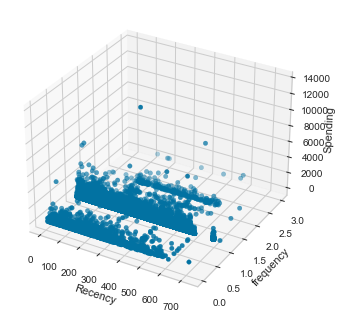

In [29]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

ax.scatter(X_RFM['Recency'], X_RFM['Frequency'], X_RFM['tot_customer_spending'])

ax.set_xlabel('Recency')
ax.set_ylabel('frequency')
ax.set_zlabel('Spending')

In [30]:
## rought categories using quartiles
# X_RFM['Spending_categories'] = pd.qcut(X_RFM['tot_customer_spending'], 3, labels = ['Low', 'Medium', ' High'])
# X_RFM['Spending_scores'] = pd.qcut(X_RFM['tot_customer_spending'], 3, labels = [1, 2, 3])
# X_RFM['Recency_categories'] = pd.qcut(X_RFM['Recency'], 3, labels = ['Long', 'Medium_t', 'Short'])
# X_RFM['Recency_scores'] = pd.qcut(X_RFM['Recency'], 3, labels = [1, 2, 3])
# X_RFM['Frequency_categories'] = pd.qcut(X_RFM['Frequency'], 3, duplicates = 'drop')

In [31]:
# 3 catégories for the amount spent
startt = time.time()

spmin = 63
spmax = 182

condition = [(X_RFM['tot_customer_spending'] < spmin),
             (X_RFM['tot_customer_spending'] >= spmin) & (X_RFM['tot_customer_spending'] < spmax),
             (X_RFM['tot_customer_spending'] >= spmax)
    ]

choice = ['Low', 'Medium', 'High']
choice2 = [1, 2, 3]

X_RFM['Spending_cat'] = np.select(condlist= condition, choicelist=choice)
X_RFM['Spending_score'] = np.select(condlist= condition, choicelist=choice2, default=0)

endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  0.008501768112182617 sec


In [32]:
# 3 catégories for the recency
startt = time.time()

rcmin = 30
rcmax = 180

condition = [(X_RFM['Recency'] < rcmin),
             (X_RFM['Recency'] >= rcmin) & (X_RFM['Recency'] < rcmax),
             (X_RFM['Recency'] >= rcmax)
    ]

choice = ['Recent', 'less than 6mth', '6mth+']
choice2 = [3, 2, 1]

X_RFM['Recency_cat'] = np.select(condlist= condition, choicelist=choice)
X_RFM['Recency_score'] = np.select(condlist= condition, choicelist=choice2, default=0)

endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  0.00900125503540039 sec


In [33]:
startt = time.time()

fmed = 1

condition = [(X_RFM['Frequency'] < fmed),
             (X_RFM['Frequency'] == fmed),
             (X_RFM['Frequency'] > fmed)
    ]

choice = ['2+ orders', '1 order', '2+ mix order']
choice2 = [3, 1, 2]

X_RFM['Frequency_cat'] = np.select(condlist= condition, choicelist=choice, default=0)
X_RFM['Frequency_score'] = np.select(condlist= condition, choicelist=choice2, default=0)

endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  0.007501840591430664 sec


In [34]:
X_RFM.head(3)

,tot_customer_spending,Recency,Frequency,Spending_cat,Spending_score,Recency_cat,Recency_score,Frequency_cat,Frequency_score
0,72.19,355.005498,1.0,Medium,2,6mth+,1,1 order,1
1,73.86,431.885150,1.0,Medium,2,6mth+,1,1 order,1
2,83.23,107.945185,1.0,Medium,2,less than 6mth,2,1 order,1


In [35]:
pd.crosstab(X_RFM['Spending_cat'], X_RFM['Recency_cat'])

Recency_cat,6mth+,Recent,less than 6mth
Spending_cat,,,
High,14121,1291,8368
Low,14396,1423,7759
Medium,28441,2716,15882


In [36]:
#pd.crosstab(X_RFM['Spending_cat'], X_RFM['Frequency_cat'])

In [37]:
#pd.crosstab(X_RFM['Recency_cat'], X_RFM['Frequency_cat'])

In [38]:
X_RFM_plot = X_RFM[['tot_customer_spending', 'Frequency', 'Recency']]

for col in X_RFM_plot.columns:
    fig = px.histogram(
            X_RFM_plot[col],
            marginal="box",
            width=900,
            height=300,
        )
    fig.show()

#### classification

In [39]:
#Final score // group
X_RFM['Score'] = X_RFM['Spending_score'] + X_RFM['Recency_score'] + X_RFM['Frequency_score'].astype(int)

In [40]:
X_RFM['Score'].value_counts()

4    35722
5    30267
3    14371
6    11044
7     2192
8      686
9      115
Name: Score, dtype: int64

In [41]:
# fig = plt.figure()
# ax = fig.add_subplot(projection='3d')

# ax.scatter(X_RFM['Recency'], X_RFM['Frequency'], X_RFM['tot_customer_spending'], cmap=X_RFM['Score'])

# ax.set_xlabel('Recency')
# ax.set_ylabel('frequency')
# ax.set_zlabel('Spending')

In [193]:
sample_RFM = X_RFM.sample(  # sample of the data (n), faster results
            n=3000,
            random_state=42)

df = sample_RFM
fig = px.scatter_3d(df, x='Recency', y='Frequency', z='tot_customer_spending',
                    color='Score')
fig.show()

<a id='Krfm' />

## Kmeans RFM

In [43]:
X_RFM['log_Spending'] = np.log1p(X_RFM['tot_customer_spending'])

In [44]:
# fig = px.histogram(X_KMeans['log_Spending'],
#             marginal="box",
#             width=600,
#             height=400
#         )
# fig.show()

In [45]:
X_RFM_Norm = std_scale.fit_transform(X_RFM[['log_Spending', 'Recency', 'Frequency']])

In [46]:
#### "Inertia" is the sum of squared distances of samples to their closest cluster center (doc sklearn)
#### sommes des distances au ² des points par rapport à leur cluster le plus proches
#### plus on augmente le nombre de cluster (ie complexité de l'algo)
#### plus on devrait réduire cette valeur

In [47]:
# Best number of clusters
startt = time.time()

inertia = []
silhouette = []

K_range = range(2, 22)
for k in K_range:
    model = KMeans(n_clusters=k).fit(X_RFM_Norm)
    inertia.append(model.inertia_)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

total time:  51.68807625770569 sec


In [48]:
#### Elbow methode
#### On recherche un coude pour déterminer le nombre de cluster idéal
#### méthode visuel potentiellement approximative
#### on veut des maths !

Text(0, 0.5, 'Cout du modèle (Inertia)')

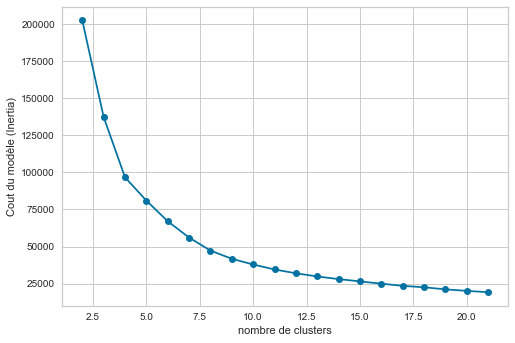

In [49]:
plt.plot(K_range, inertia, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('Cout du modèle (Inertia)')

In [50]:
# Best number of clusters
startt = time.time()

inertia = []
silhouette = []

K_range = range(2, 10)
for k in K_range:
    
    cls = cluster.KMeans(n_clusters=k)
    cls.fit(X_RFM_Norm)
    silh = metrics.silhouette_score(X_RFM_Norm, cls.labels_)
    silhouette.append(silh)
    
    print(k)
    
endt = time.time()
print("total time: ",(endt - startt),"sec")

2
3
4
5
6
7
8
9
total time:  611.7830624580383 sec


Text(0, 0.5, 'silhoutte')

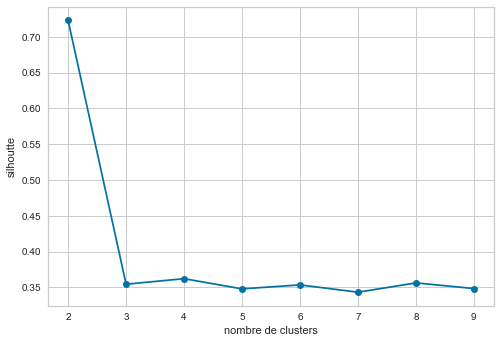

In [51]:
plt.plot(K_range, silhouette, 'o-')
plt.xlabel('nombre de clusters')
plt.ylabel('silhoutte')

#### The silhouette coeff shows that the best number of clusters is 4 (6 or 8 are also good, if we exclude 2) 

In [52]:
model = KMeans(n_clusters=4)
model.fit(X_RFM_Norm)
model.labels_

array([1, 1, 3, ..., 1, 0, 3])

In [53]:
X_RFM['cluster'] = model.labels_

In [54]:
X_RFM['cluster'].value_counts()

3    36359
0    28266
1    27606
2     2166
Name: cluster, dtype: int64

In [194]:
sample_RFM = X_RFM.sample(  # sample of the data (n), faster results
            n=3000,
            random_state=42)

df = sample_RFM
fig = px.scatter_3d(df, x='Recency', y='Frequency', z='tot_customer_spending',
                    color='cluster')
fig.show()

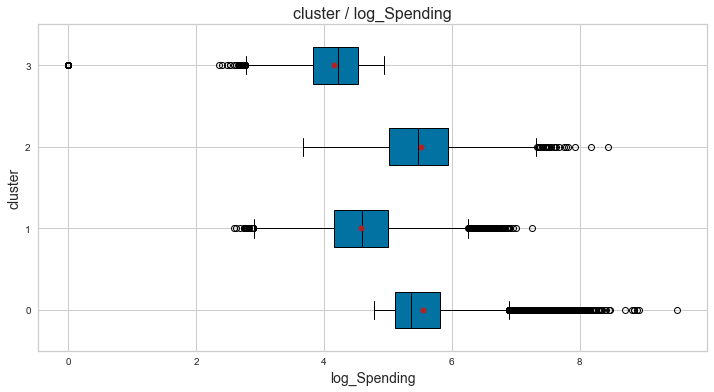

                   sum_sq       df             F  PR(>F)
C(catquali)  32635.099076      3.0  33099.717555     0.0
Residual     31022.670631  94393.0           NaN     NaN


In [55]:
boxplots(X_RFM, 'cluster', 'log_Spending', tukey=0, size=(12,6), showfliers=True, sort = 1, font=12)

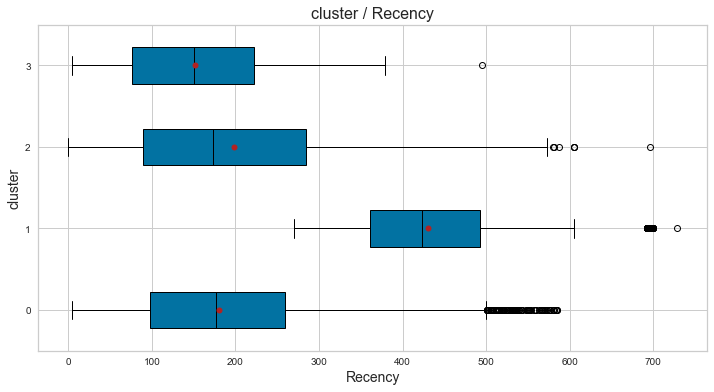

                   sum_sq       df            F  PR(>F)
C(catquali)  1.388798e+09      3.0  53786.94613     0.0
Residual     8.124202e+08  94393.0          NaN     NaN


In [56]:
boxplots(X_RFM, 'cluster', 'Recency', tukey=0, size=(12,6), showfliers=True, sort = 1, font=12)

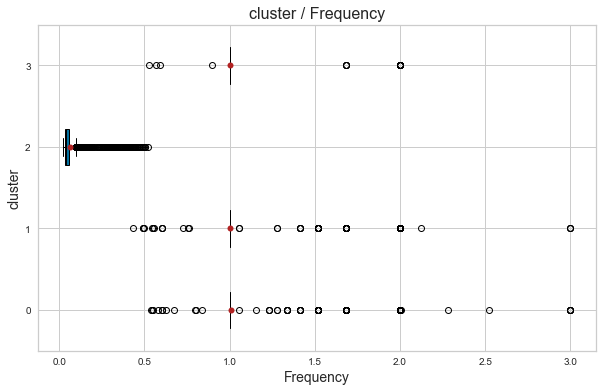

                  sum_sq       df              F  PR(>F)
C(catquali)  1876.806102      3.0  156199.984087     0.0
Residual      378.056715  94393.0            NaN     NaN


In [57]:
boxplots(X_RFM, 'cluster', 'Frequency', tukey=0, size=(10,6), showfliers=True, sort = 1, font=10)

#### number of clusters : k = 7

In [58]:
model = KMeans(n_clusters=7)
model.fit(X_RFM_Norm)
model.labels_

array([4, 4, 2, ..., 0, 1, 3])

In [59]:
X_RFM['cluster7'] = model.labels_

In [60]:
X_RFM['cluster7'].value_counts()

3    29226
2    20094
4    19045
0    14652
1     8820
5     2167
6      393
Name: cluster7, dtype: int64

In [197]:
X_RFM.head(1)

,tot_customer_spending,Recency,Frequency,Spending_cat,Spending_score,Recency_cat,Recency_score,Frequency_cat,Frequency_score,Score,log_Spending,cluster,cluster7
0,72.19,355.005498,1.0,Medium,2,6mth+,1,1 order,1,4,4.293059,1,4


In [195]:
sample_RFM = X_RFM.sample(  # sample of the data (n), faster results
            n=3000,
            random_state=42)

df = sample_RFM
fig = px.scatter_3d(df, x='Recency', y='Frequency', z='tot_customer_spending',
                    color='cluster7')
fig.show()

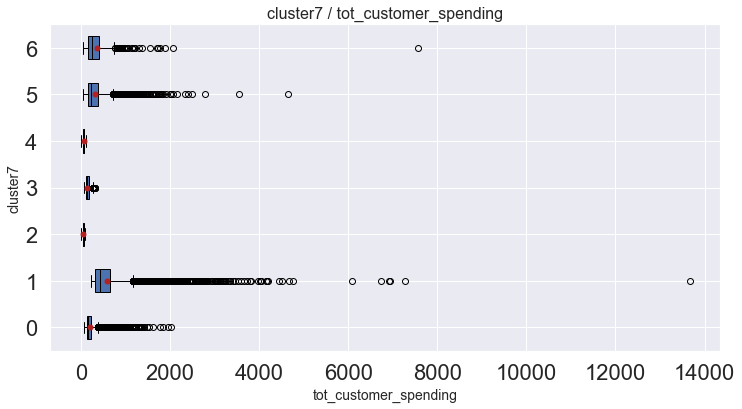

                   sum_sq       df             F  PR(>F)
C(catquali)  2.158582e+09      6.0  12431.317232     0.0
Residual     2.731657e+09  94390.0           NaN     NaN


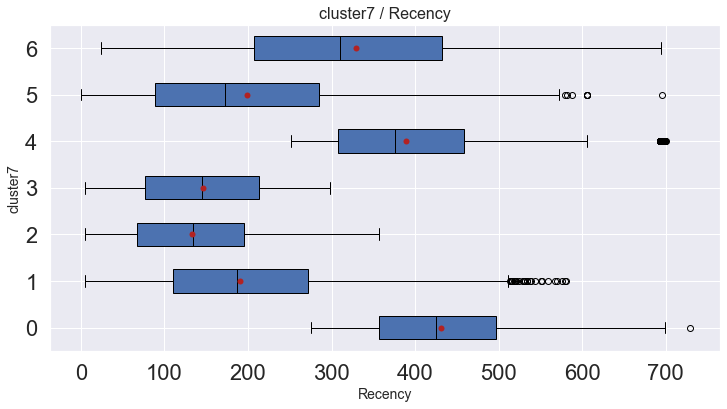

                   sum_sq       df             F  PR(>F)
C(catquali)  1.483497e+09      6.0  32516.629941     0.0
Residual     7.177213e+08  94390.0           NaN     NaN


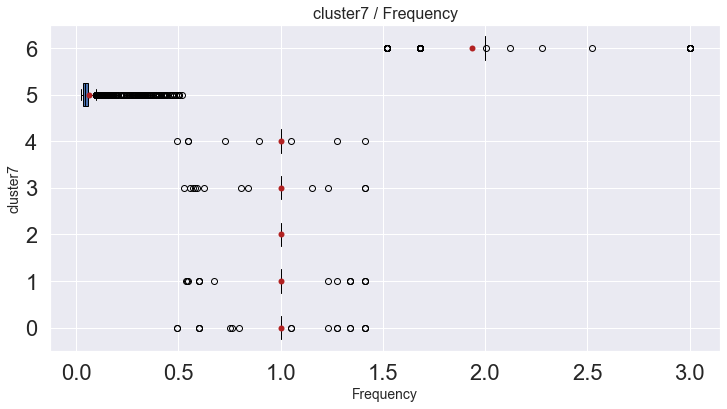

                  sum_sq       df              F  PR(>F)
C(catquali)  2217.960171      6.0  945520.553471     0.0
Residual       36.902646  94390.0            NaN     NaN


In [200]:
plotcatrf = list(X_RFM)

for i in range(3) :
    boxplots(X_RFM, 'cluster7', plotcatrf[i], tukey=0, size=(12,6), showfliers=True, sort = 1, font=12)

#### We find in a way similar groups influenced by our splitting of the different attibuts, in the future, we don't want to handle things by hand (except for specific purpose), to avoid bias and non optimized groups.

#### Since we have very little data for a good RFM classification which is a very basic analysis, we need to add more variables in the model to fit the client persona.